In [28]:
import pandas as pd

# Load the uploaded CSV file
file_path = 'valid_100users_traj/cityB_valid_100users.csv'
original_data_path = 'HuMob2024/cityB_challengedata.csv.gz'
original_data = pd.read_csv(original_data_path, compression='gzip')
data = pd.read_csv(file_path)

# Display the first few rows to understand the data structure
data.head()

,uid,d,t,x,y
0,17600,0,17,79,84
1,17600,0,32,79,83
2,17600,0,33,79,84
3,17600,0,41,79,85
4,17600,1,21,78,84


In [29]:
trajectory = original_data[(original_data['uid'] == 17652)]
trajectory = trajectory[['d', 't', 'x', 'y']].values.tolist()
trajectory_original = original_data[(original_data['uid'] == 17652) & (original_data['d'] >= 60)]
trajectory_original = trajectory_original[['d', 't', 'x', 'y']].values.tolist()

In [30]:
trajectory_bert = data[(data['uid'] == 17652) & (data['d'] >= 60)]
trajectory_bert = trajectory_bert[['d', 't', 'x', 'y']].values.tolist()

In [31]:
file_path = 'wandb_export_2024-10-05T16_33_16.460+08_00.csv'
df = pd.read_csv(file_path)
filtered_df = df[(df['conversation_id'] == 54) & (df['dtw'] > 100)]
filtered_df

,conversation_id,processing_time,generated_response,reference_response,geobleu,dtw,Input_sequence_length
295,54,54.655797,"{""reason"": ""The individual's trajectory shows ...","{""reason"": ""The individual's trajectory shows ...",2.340768e-07,509.858427,2629


In [32]:
import json

trajectory_llm = filtered_df['generated_response'].apply(lambda x: json.loads(x)['prediction']).tolist()[0]
print(trajectory_llm)

[[60, 25, 88, 158], [60, 27, 88, 168], [60, 29, 90, 166], [60, 30, 92, 125], [60, 31, 92, 125], [60, 32, 93, 104], [60, 33, 49, 45], [60, 35, 44, 46], [61, 31, 26, 40], [61, 32, 35, 44], [61, 33, 51, 46], [61, 34, 58, 55], [61, 35, 93, 84], [66, 15, 194, 174], [66, 16, 144, 134], [66, 17, 93, 84], [66, 18, 94, 86], [66, 22, 93, 85], [66, 23, 93, 85], [66, 25, 93, 85], [66, 26, 94, 86], [66, 27, 93, 85], [66, 28, 94, 86], [66, 29, 93, 85], [66, 30, 93, 85], [66, 31, 93, 85], [66, 32, 94, 86], [66, 33, 93, 85], [66, 34, 94, 86], [66, 37, 94, 86], [66, 38, 94, 86], [66, 39, 93, 85], [73, 18, 177, 13], [73, 19, 178, 14], [73, 20, 177, 13], [73, 21, 177, 13], [73, 22, 178, 14], [73, 24, 177, 13], [73, 25, 178, 14], [73, 26, 177, 13], [73, 27, 178, 14], [73, 28, 177, 13], [73, 29, 178, 14], [73, 30, 178, 14], [73, 31, 177, 13], [73, 32, 178, 14], [73, 33, 178, 14], [73, 36, 178, 14], [73, 38, 178, 14], [73, 45, 178, 14], [74, 3, 178, 14], [74, 4, 177, 13], [74, 5, 178, 14], [74, 6, 178, 14],

In [33]:
trajectory_1 = trajectory_bert
trajectory_2 = trajectory_original
trajectory_3 = trajectory_llm
trajectory_4 = trajectory_original

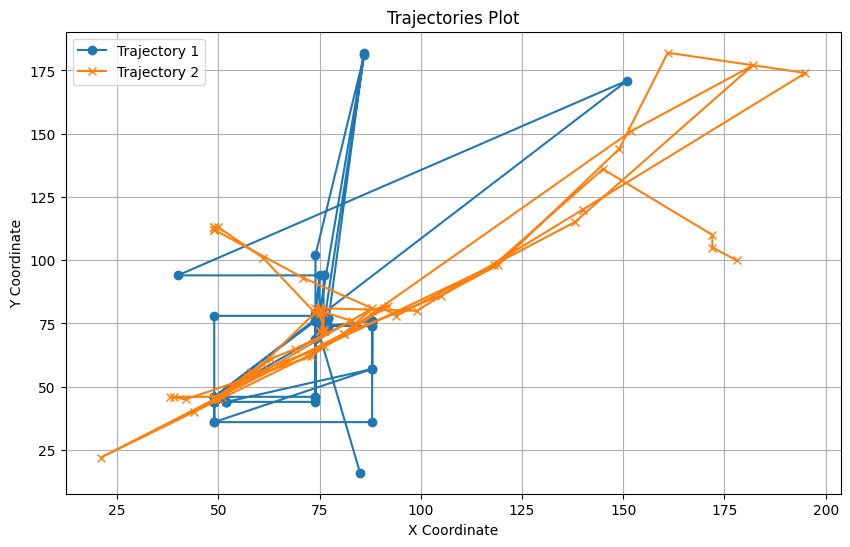

In [34]:
import matplotlib.pyplot as plt

# Extract x and y coordinates for each trajectory
x1, y1 = zip(*[(point[2], point[3]) for point in trajectory_1])
x2, y2 = zip(*[(point[2], point[3]) for point in trajectory_2])
x3, y3 = zip(*[(point[2], point[3]) for point in trajectory_3])
x4, y4 = zip(*[(point[2], point[3]) for point in trajectory_4])

# Plot the trajectories
plt.figure(figsize=(10, 6))
plt.plot(x1, y1, marker='o', label='Trajectory 1')
plt.plot(x2, y2, marker='x', label='Trajectory 2')
# plt.plot(x3, y3, marker='s', label='Trajectory 3')
# plt.plot(x4, y4, marker='d', label='Trajectory 4')

plt.title('Trajectories Plot')
plt.xlabel('X Coordinate')
plt.ylabel('Y Coordinate')
plt.legend()
plt.grid(True)
plt.show()

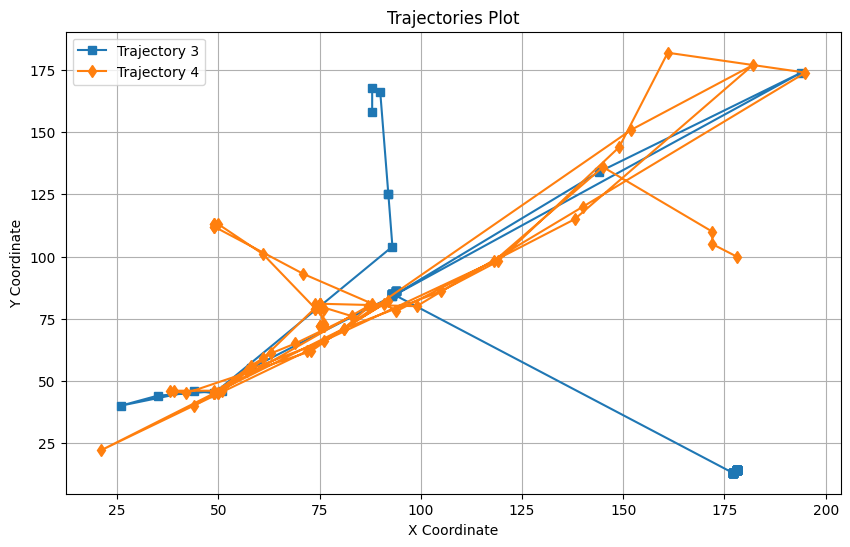

In [35]:
import matplotlib.pyplot as plt

# Plot the trajectories
plt.figure(figsize=(10, 6))
# plt.plot(x1, y1, marker='o', label='Trajectory 1')
# plt.plot(x2, y2, marker='x', label='Trajectory 2')
plt.plot(x3, y3, marker='s', label='Trajectory 3')
plt.plot(x4, y4, marker='d', label='Trajectory 4')

plt.title('Trajectories Plot')
plt.xlabel('X Coordinate')
plt.ylabel('Y Coordinate')
plt.legend()
plt.grid(True)
plt.show()

Animation size has reached 21028615 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


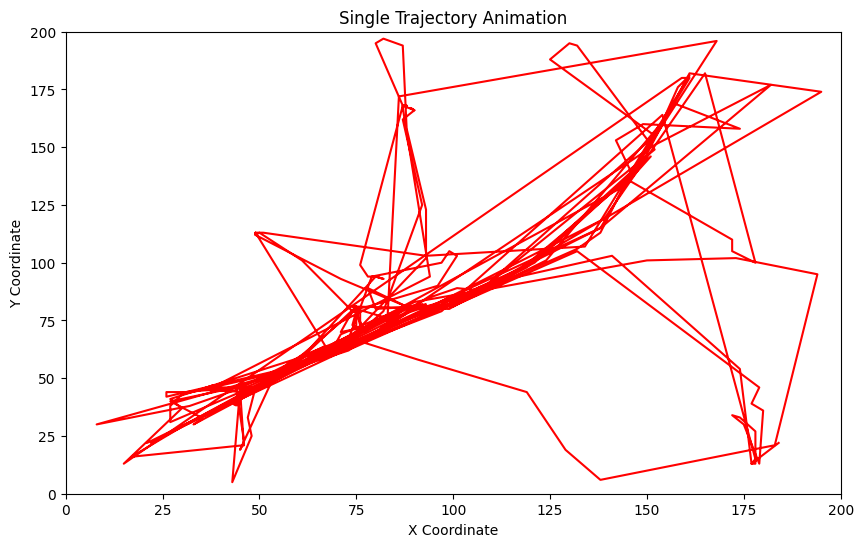

In [36]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.animation as animation
from IPython.display import HTML

fig, ax = plt.subplots(figsize=(10, 6))
ax.set_xlim(0, 200)
ax.set_ylim(0, 200)
ax.set_title('Single Trajectory Animation')
ax.set_xlabel('X Coordinate')
ax.set_ylabel('Y Coordinate')

# Initialize a line and scatter plot for the single trajectory
line, = ax.plot([], [], color='red', label='Trajectory')
scatter = ax.scatter([], [], color='red')

def init():
    line.set_data([], [])
    scatter.set_offsets(np.array([[], []]).T)
    return line, scatter

def update(frame):
    if frame < len(trajectory):
        x = [point[2] for point in trajectory[:frame+1]]
        y = [point[3] for point in trajectory[:frame+1]]
        line.set_data(x, y)
        scatter.set_offsets(np.c_[x[-1:], y[-1:]])
    return line, scatter

# Create the animation
ani = animation.FuncAnimation(fig, update, frames=len(trajectory), init_func=init, blit=True)

# Display the animation in the notebook
HTML(ani.to_jshtml())

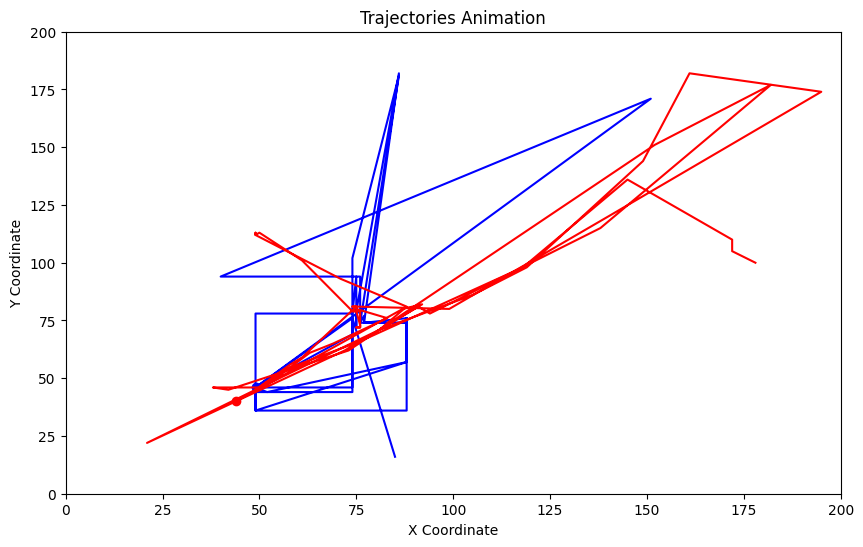

In [37]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.animation as animation
from IPython.display import HTML

# Combine the two trajectories into a list
trajectories = [trajectory_1, trajectory_2]
labels = ['Trajectory 1', 'Trajectory 2']
colors = ['blue', 'red']

# Setup the figure and axis
fig, ax = plt.subplots(figsize=(10, 6))
ax.set_xlim(0, 200)
ax.set_ylim(0, 200)
ax.set_title('Trajectories Animation')
ax.set_xlabel('X Coordinate')
ax.set_ylabel('Y Coordinate')

# Initialize lines for each trajectory
lines = [ax.plot([], [], color=color, label=label)[0] for color, label in zip(colors, labels)]
scatters = [ax.scatter([], [], color=color) for color in colors]

def init():
    for line in lines:
        line.set_data([], [])
    for scatter in scatters:
        scatter.set_offsets(np.array([[], []]).T)
    return lines + scatters

def update(frame):
    for line, scatter, trajectory in zip(lines, scatters, trajectories):
        if frame < len(trajectory):
            x = [point[2] for point in trajectory[:frame+1]]
            y = [point[3] for point in trajectory[:frame+1]]
            line.set_data(x, y)
            scatter.set_offsets(np.c_[x[-1:], y[-1:]])
    return lines + scatters

# Create the animation
ani = animation.FuncAnimation(fig, update, frames=max(len(traj) for traj in trajectories), init_func=init, blit=True)

# Display the animation in the notebook
HTML(ani.to_jshtml())

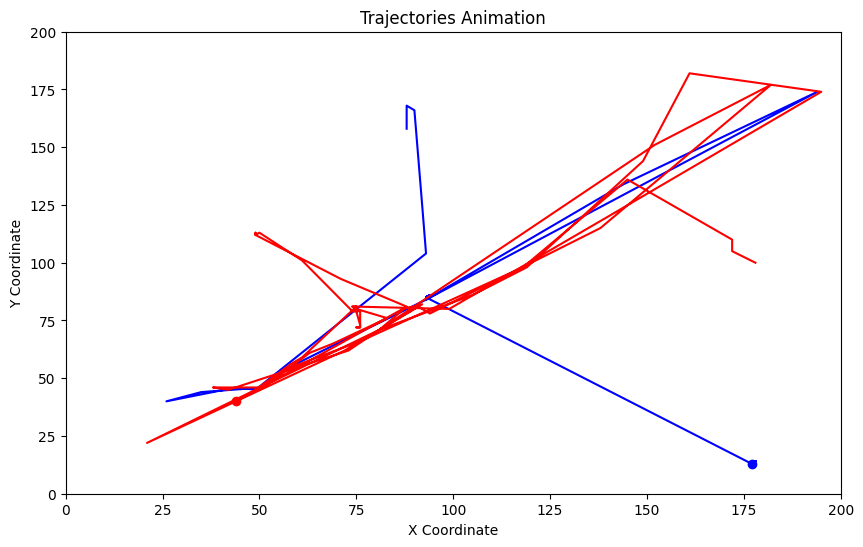

In [38]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.animation as animation
from IPython.display import HTML

# Combine the two trajectories into a list
trajectories = [trajectory_3, trajectory_4]
labels = ['Trajectory 1', 'Trajectory 2']
colors = ['blue', 'red']

# Setup the figure and axis
fig, ax = plt.subplots(figsize=(10, 6))
ax.set_xlim(0, 200)
ax.set_ylim(0, 200)
ax.set_title('Trajectories Animation')
ax.set_xlabel('X Coordinate')
ax.set_ylabel('Y Coordinate')

# Initialize lines for each trajectory
lines = [ax.plot([], [], color=color, label=label)[0] for color, label in zip(colors, labels)]
scatters = [ax.scatter([], [], color=color) for color in colors]

def init():
    for line in lines:
        line.set_data([], [])
    for scatter in scatters:
        scatter.set_offsets(np.array([[], []]).T)
    return lines + scatters

def update(frame):
    for line, scatter, trajectory in zip(lines, scatters, trajectories):
        if frame < len(trajectory):
            x = [point[2] for point in trajectory[:frame+1]]
            y = [point[3] for point in trajectory[:frame+1]]
            line.set_data(x, y)
            scatter.set_offsets(np.c_[x[-1:], y[-1:]])
    return lines + scatters

# Create the animation
ani = animation.FuncAnimation(fig, update, frames=max(len(traj) for traj in trajectories), init_func=init, blit=True)

# Display the animation in the notebook
HTML(ani.to_jshtml())